In [1]:
import numpy as np
import cv2
from PIL import Image
from matplotlib import pyplot as plt

In [2]:
def calc_connectivity(slice):
    connectivity = 0
    last_data = 0
    open_part = False
    connective_parts = []
    for i, data in enumerate(slice):
        if last_data == 0 and data == 1:
            open_part = True
            start_point = i
        elif last_data == 1 and data == 0 and open_part:
            open_part = False
            connectivity += 1
            end_point = i
            connective_parts.append((start_point, end_point))

        last_data = data
    return connectivity, connective_parts

In [3]:
def bcd(erode_img):
    last_connectivity = 0
    last_connectivity_parts = []
    current_cell = 1
    current_cells = []
    separate_img = np.copy(erode_img)
    
    for col in range(erode_img.shape[1]):
        #print("ok")
        slice = separate_img[:, col]
        connectivity, connective_parts = calc_connectivity(slice)
        
        if last_connectivity == 0:
            current_cells = []
            for i in range(connectivity):
                current_cells.append(current_cell)
                current_cell += 1
                #print(current_cells)
        elif connectivity == 0:
            current_cells = []
            continue
        else:
            cells = [0] * len(connective_parts)
            

            if not last_connect_parts == connective_parts:
                for i in range(len(connective_parts)):
                    cells[i] = current_cell
                    current_cell += 1
                #print(cells)
            else:
                cells = current_cells
            current_cells = cells
        for cell, slice in zip(current_cells, connective_parts):
            separate_img[slice[0]:slice[1], col] = cell
            
        last_connectivity = connectivity
        last_connect_parts = connective_parts
    no_cells = cells[-1]
    #print(current_cell)
    return separate_img, current_cell


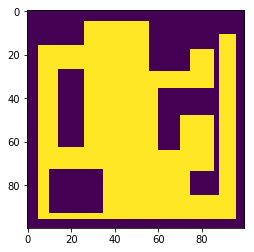

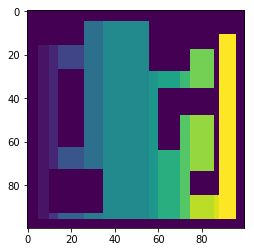

20


In [4]:
img = np.array(Image.open('map_6.png'))
if len(img.shape) > 2:
    img = img[:, :, 0]

for i in range(img.shape[0]):
    for j in range(img.shape[1]):
        if img[i, j] > 0:
            img[i, j] = 255

erode_img = img / np.max(img)
#bcd(erode_img)
plt.imshow(erode_img)
plt.show()
separate_img, cells = bcd(erode_img)
plt.imshow(separate_img)
plt.show()
print(cells)
#import sys
#np.set_printoptions(threshold=sys.maxsize)
#print(separate_img)

In [5]:
img = np.array(Image.open('map_6.png'))
if len(img.shape) > 2:
    img = img[:, :, 0]

erode_img = img // np.max(img)
separate_img, cells = bcd(erode_img)
#print(separate_img)

In [6]:
def extract_points():
    points = []
    for i in range(1, cells):
        p = np.argwhere(separate_img == i)
        points.append(p)
    #print(points)
    end_points = []
    for point in points:
        #top left - min r, min c
        #bottom left - max r, min c
        #top right - min r, max c
        #bottom right - max r, max c
        tl = point[0]
        br = point[-1]
        min_r = 100000
        max_r = -1
        for p in point:
            if p[0] > max_r:
                max_r = p[0]
            if p[0] < min_r:
                min_r = p[0]
        length = max_r - min_r
        min_c = 100000
        max_c = -1
        for p in point:
            if p[1] > max_c:
                max_c = p[1]
            if p[0] < min_c:
                min_c = p[1]
        width = max_c - min_c
        bl = [tl[0]+length, tl[1]]
        tr = [br[0]-length, br[1]]
        po = []
        po.append(tl.tolist())
        po.append(bl)
        po.append(br.tolist())
        po.append(tr)
        end_points.append(po)
    return end_points
        
end = extract_points()
print(end)

[[[16, 5], [95, 5], [95, 9], [16, 9]], [[16, 10], [72, 10], [72, 13], [16, 13]], [[93, 10], [95, 10], [95, 13], [93, 13]], [[16, 14], [26, 14], [26, 25], [16, 25]], [[63, 14], [72, 14], [72, 25], [63, 25]], [[93, 14], [95, 14], [95, 25], [93, 25]], [[5, 26], [72, 26], [72, 34], [5, 34]], [[93, 26], [95, 26], [95, 34], [93, 34]], [[5, 35], [95, 35], [95, 55], [5, 55]], [[28, 56], [95, 56], [95, 59], [28, 59]], [[28, 60], [35, 60], [35, 69], [28, 69]], [[64, 60], [95, 60], [95, 69], [64, 69]], [[28, 70], [35, 70], [35, 74], [28, 74]], [[48, 70], [95, 70], [95, 74], [48, 74]], [[18, 75], [35, 75], [35, 85], [18, 85]], [[48, 75], [73, 75], [73, 85], [48, 85]], [[85, 75], [95, 75], [95, 85], [85, 85]], [[85, 86], [95, 86], [95, 87], [85, 87]], [[11, 88], [95, 88], [95, 95], [11, 95]]]


In [7]:
def already_exists(a, l):
    for i in range(len(l)):
        if l[i] == a:
            return True
    return False

def find_neighbours():
    neighbours = []
    for i in range(1, cells):
        neigh = []
        for j in range(separate_img.shape[0]):
            for k in range(separate_img.shape[1]):
                if separate_img[j][k] == i:
                    if k+1 > separate_img.shape[0]-1 or k-1 < 0:
                        continue
                    if not separate_img[j][k+1] == i:
                        if already_exists(separate_img[j][k+1], neigh) or separate_img[j][k+1] == 0:
                            continue
                        else:
                            neigh.append(separate_img[j][k+1])
                    if not separate_img[j][k-1] == i:
                        if already_exists(separate_img[j][k-1], neigh) or separate_img[j][k-1] == 0:
                            continue
                        else:
                            neigh.append(separate_img[j][k-1])
        neighbours.append(neigh)
    return neighbours

In [8]:
neighbours = find_neighbours()
print(neighbours)

[[2, 3], [1, 4, 5], [1, 6], [2, 7], [2, 7], [3, 8], [9, 4, 5], [6, 9], [7, 10, 8], [9, 11, 12], [10, 13], [10, 14], [11, 15], [16, 12, 17], [13], [14], [14, 18], [17, 19], [18]]


In [9]:
visited = np.zeros((cells, ))
#print(visited.shape)
current = 1
order = []
current_stack = []
def dfs(current, current_stack):
    #print(current_stack)
    #print(current)
    if visited[current-1] == 0:
        current_stack.append(current)
        order.append(current)
        visited[current-1] = 1
    else:
        current_stack.pop(-1)
        if len(current_stack) == 0:
            return order
        current = current_stack[-1]
        if(len(current_stack) == 0):
            print("ok")
    #print("--- ", current)
    neigh = neighbours[current - 1]
    #print(neigh)
    for next in neigh:
        #print(next)
        next = int(next)
        if visited[next-1] == 0:
            current = next
            break
    dfs(current, current_stack)
dfs(current, current_stack)
print(order)    
#print(visited)
map = separate_img


[1, 2, 4, 7, 9, 10, 11, 13, 15, 12, 14, 16, 17, 18, 19, 8, 6, 3, 5]


In [10]:
print(order)
print(visited)

[1, 2, 4, 7, 9, 10, 11, 13, 15, 12, 14, 16, 17, 18, 19, 8, 6, 3, 5]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.]


In [11]:
import math
import time
from IPython.display import clear_output
def check_empty(points, cell):
    start = points[0]
    stop = points[2]
    for i in range(start[0], stop[0]+1):
        for j in range(start[1], stop[1]+1):
            if map[i][j] == cell:
                return True     # empty
    return False   # completely covered

def traverse(points, start_pos, cell):
    if start_pos == 0:       # move right
        current_r, current_c = points[start_pos][0], points[start_pos][1] 
        dir = "down"
    
        while(check_empty(points, cell)):
            if dir == "down":
                map[current_r][current_c] = cells + 1
                if not map[current_r+1][current_c] == cell:
                    current_c += 1
                    dir = "up"
                    continue
                current_r += 1
            
            if dir == "up":
                map[current_r][current_c] = cells + 1
                if not map[current_r-1][current_c] == cell:
                    current_c += 1
                    dir = "down"
                    continue
                current_r -= 1
            plt.imshow(map)
            plt.show()
            #time.sleep(0.2)
            #clear_output()
        
    elif start_pos == 1:
        current_r, current_c = points[start_pos][0], points[start_pos][1] 
        dir = "up"
    
        while(check_empty(points, cell)):
            if dir == "down":
                map[current_r][current_c] = cells + 1
                if not map[current_r+1][current_c] == cell:
                    current_c += 1
                    dir = "up"
                    continue
                current_r += 1
            
            if dir == "up":
                map[current_r][current_c] = cells + 1
                if not map[current_r-1][current_c] == cell:
                    current_c += 1
                    dir = "down"
                    continue
                current_r -= 1
            plt.imshow(map)
            plt.show()
            #time.sleep(0.2)
            #clear_output()
    elif start_pos == 2:
        current_r, current_c = points[start_pos][0], points[start_pos][1] 
        dir = "up"
    
        while(check_empty(points, cell)):
            if dir == "down":
                map[current_r][current_c] = cells + 1
                if not map[current_r+1][current_c] == cell:
                    current_c -= 1
                    dir = "up"
                    continue
                current_r += 1
            
            if dir == "up":
                map[current_r][current_c] = cells + 1
                if not map[current_r-1][current_c] == cell:
                    current_c -= 1
                    dir = "down"
                    continue
                current_r -= 1
            plt.imshow(map)
            plt.show()
            #time.sleep(0.2)
            #clear_output()
        
    else:
        current_r, current_c = points[start_pos][0], points[start_pos][1] 
        dir = "down"
    
        while(check_empty(points, cell)):
            if dir == "down":
                map[current_r][current_c] = cells + 1
                if not map[current_r+1][current_c] == cell:
                    current_c -= 1
                    dir = "up"
                    continue
                current_r += 1
            
            if dir == "up":
                map[current_r][current_c] = cells + 1
                if not map[current_r-1][current_c] == cell:
                    current_c -= 1
                    dir = "down"
                    continue
                current_r -= 1
            plt.imshow(map)
            plt.show()
            #time.sleep(0.2)
            #clear_output()
    
        
        #time.sleep(0.2)
        #clear_output()
    return current_r, current_c

def next_nearest(current_r, current_c, points):
    min = 999999
    #print(current_r, current_c)
    for i in range(len(points)):
        point = points[i]
        #print()
        dist = math.sqrt((current_r - point[0]) ** 2 + (current_c - point[1]) ** 2)
        if dist < min:
            nearest = i
            min = dist
    return nearest



1


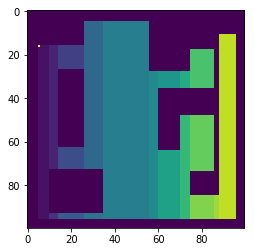

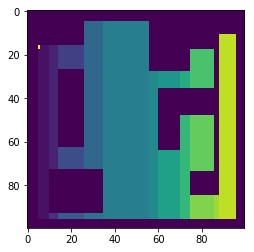

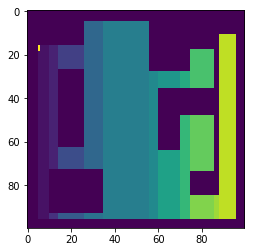

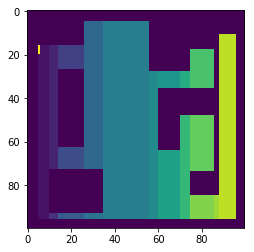

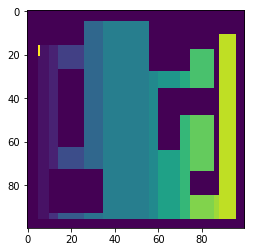

...

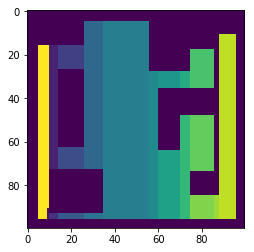

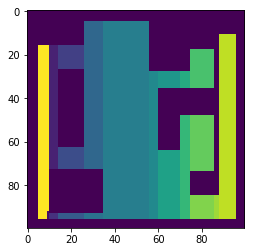

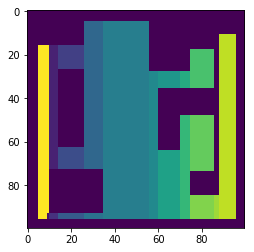

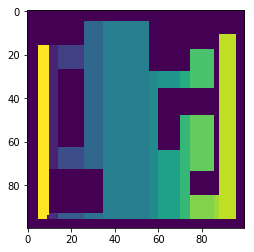

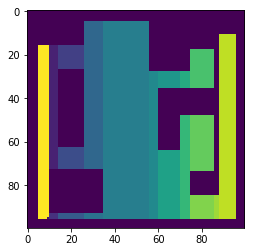

2


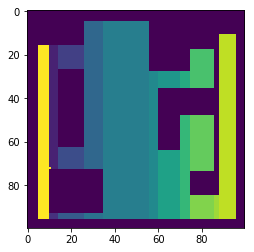

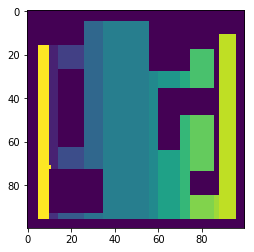

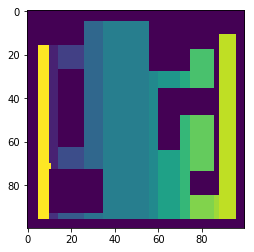

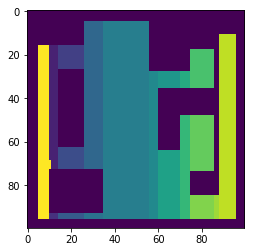

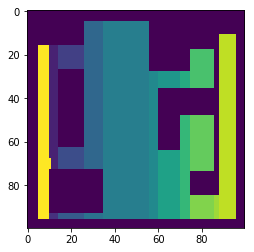

...

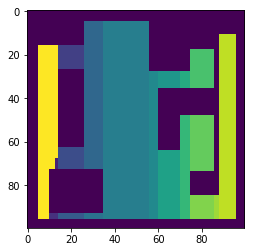

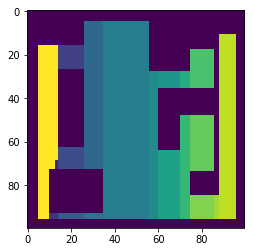

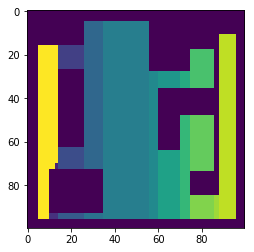

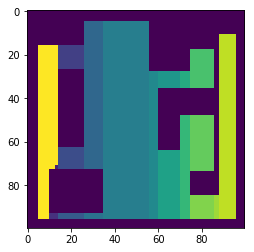

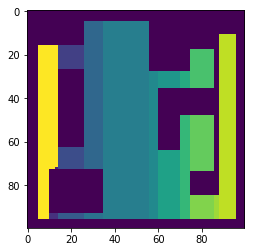

4


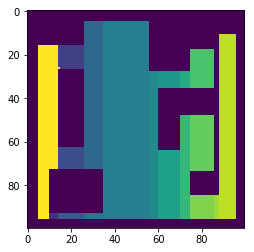

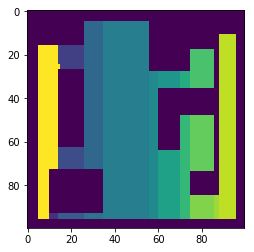

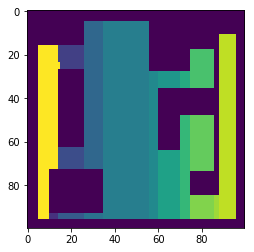

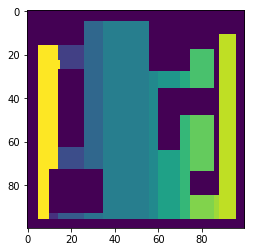

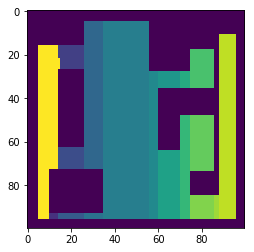

...

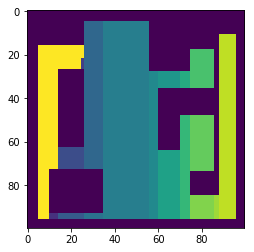

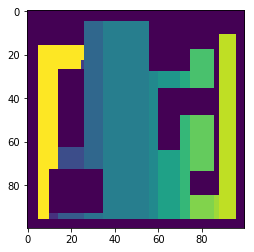

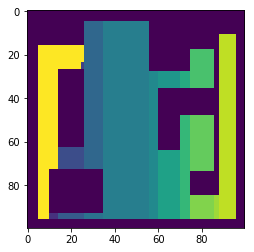

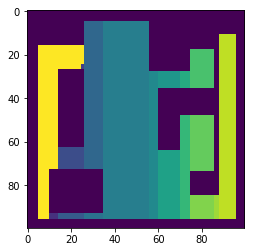

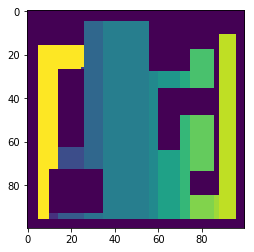

7


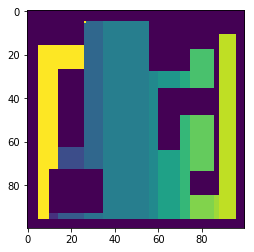

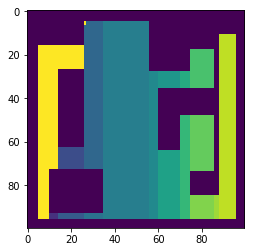

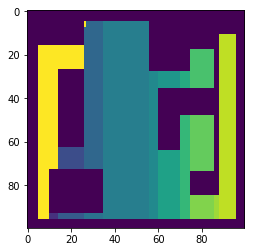

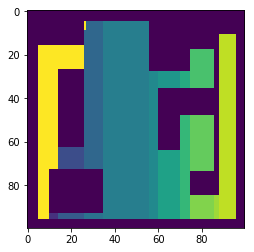

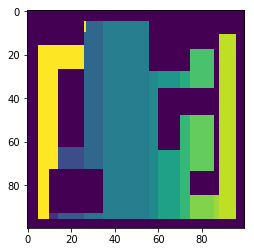

...

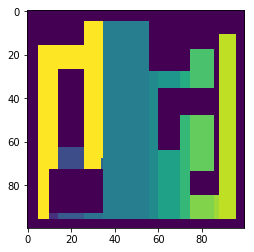

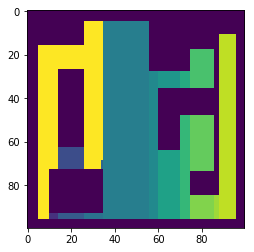

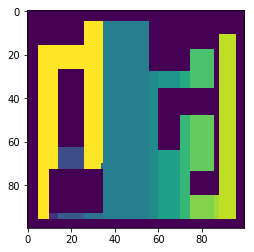

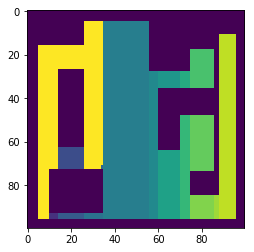

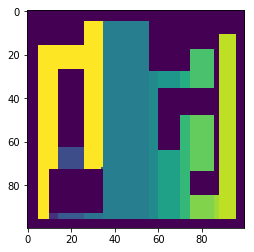

9


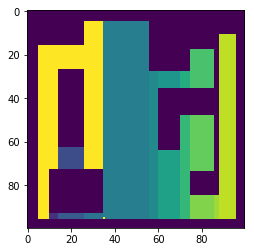

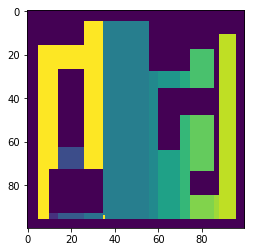

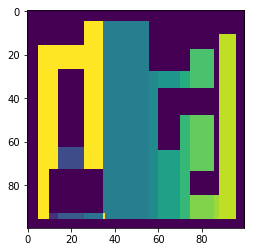

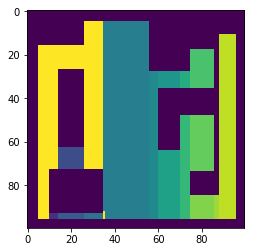

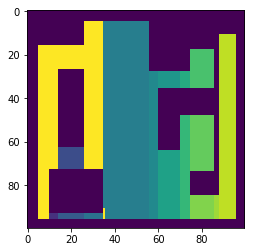

...

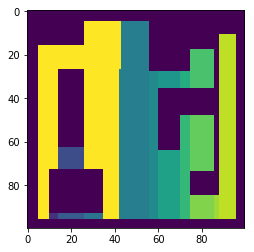

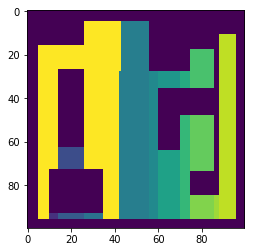

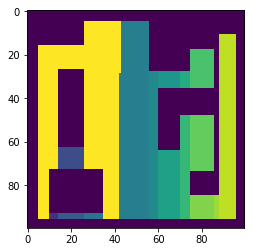

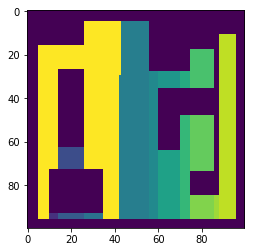

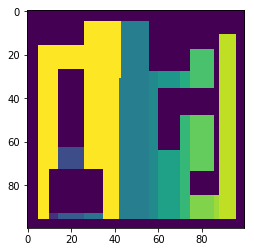

10


11


13


15


12


14


16


17


18


19


8


6


3


5


In [12]:
if __name__ == "__main__":
    points = extract_points()
    start_pos = 5
    for i in order:
        print(i)
        if start_pos == 5:
            current_r, current_c = traverse(points[i-1], 0, i)
            start_pos = 0
        else:
            start_pos = next_nearest(current_r, current_c, points[i-1])
            current_r, current_c = traverse(points[i-1], start_pos, i)

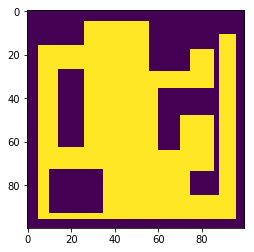

In [132]:
plt.imshow(map)
plt.show()

14